In [1]:
%matplotlib inline
from matplotlib import pyplot as plt
import seaborn as sns

import pandas as pd
import scanpy as sc
import numpy as np

from scipy.spatial import Voronoi, Delaunay, ConvexHull
from scipy.spatial import delaunay_plot_2d, voronoi_plot_2d

from matplotlib import rcParams
rcParams['figure.facecolor'] = (1,1,1,1)
rcParams['svg.fonttype'] = 'none'

import cuml

In [2]:
adata = sc.read_h5ad("/storage/codex/datasets_v1/bladder_merged_v10.h5ad")
adata

AnnData object with n_obs × n_vars = 598327 × 1440
    obs: 'CD45_ringpct', 'CD20_ringpct', 'CD3e_ringpct', 'CD45RO_ringpct', 'CD45RA_ringpct', 'CD8_ringpct', 'CD4_ringpct', 'CDH12_ringpct', 'KRT13_ringpct', 'KRT17_ringpct', 'PanCytoK_ringpct', 'ERBB2_ringpct', 'sample_id', 'sample_id_printing', 'snSeq_sample', 'patient', 'biopsy', 'Filtered_DAPI', 'cell_gates', 'celltype_gating', 'subtype_gates', 'subtype_gating', 'subtype_rescued', 'subtype', 'celltype', 'cell_niches', 'niche_labels'
    uns: 'celltype_colors', 'channels', 'niche_labels_colors', 'niche_profiles_colnames', 'patient_colors', 'sample_id_printing_colors', 'sample_layout', 'snSeq_sample_colors', 'subtype_colors', 'subtype_gating_colors'
    obsm: 'coordinates', 'coordinates_shift', 'niche_profiles'

In [97]:
import itertools

"""
Create a plot like Fig. 6A, Schurch (2020)

Plus some extra stuff
"""
def draw_highlight_cells(ad, coords, celltype, key, ax, max_dist, annot_str, triangulation=False):
    ix = ad.obs[key] == celltype
    cells = coords[ix]
#     dist = np.linalg.norm(cells, ord=2, axis=1)
#     cells = cells[dist < max_dist]
    ax.scatter(cells[:,0], cells[:,1], color='k', s=0.2, zorder=3)
    
    if triangulation:
        tri = Delaunay(cells)
        #_=delaunay_plot_2d(tri, ax=ax, color=)
        
        ds = []
        for triangle in tri.simplices:
            tri_pts = tri.points[triangle]
            for p1, p2 in itertools.combinations(tri_pts, 2):
                d = np.sqrt( (p1[0]-p2[0])**2 + (p1[1]-p2[1])**2 )
                ds.append(d)
            
        ds = np.mean(ds)
        ax.triplot(tri.points[:,0], tri.points[:,1], tri.simplices, lw=0.2, color='k')
        annot_str += f'\nTriangulation: {celltype} cells\nMean triangle edge length={ds:3.4f}'
    else:
        annot_str += f'\nDots: {celltype} cells'
    
    return annot_str



def draw_colored_voronoi(ad, colors, label_key='celltype', ax=None, voronoi_color=None, 
                         highlight_celltype=None, highlight_key=None, triangulation=False,
                         adjust_polygons=True, max_dist=100, annotate=True
                        ):
    if ax is None:
        plt.figure(figsize=(6,6), dpi=180)
        ax = plt.gca()
    
    # Convex hull to find the edge points, and toss them later
    # Center coordinates, so we can filter based on the distance from the origin
    coords = ad.obsm['coordinates'].copy()
    coords[:,0] = coords[:,0] - np.median(coords[:,0])
    coords[:,1] = coords[:,1] - np.median(coords[:,1])
    hull = ConvexHull(coords)
    vor = Voronoi(coords, furthest_site=False)

    _=voronoi_plot_2d(vor, ax=ax, show_points=False, show_vertices=False, 
                      line_width=0, line_colors=None)

    mag = np.linalg.norm(coords, ord=2, axis=1)
    vert_mag_cutoff = np.min(mag[hull.vertices])
    
    if voronoi_color is None:
        voronoi_color = np.unique(ad.obs[label_key])

    def filter_pt(pt):
        return True if np.linalg.norm(pt, ord=2) < vert_mag_cutoff else False

    drawn_coords = []
    for r in range(len(vor.point_region)):
        # r is the corresponding cell.
        region = vor.regions[vor.point_region[r]]
        pt = coords[r]
        if -1 in region:
            continue

        polygon = [vor.vertices[i] for i in region]
        if adjust_polygons:
            adjusted_poly = []
            for ppt in polygon:
                d = np.sqrt((ppt[0]-pt[0])**2 + (ppt[1]-pt[1])**2)
                if d > max_dist:
                    continue
                else:
                    adjusted_poly.append(ppt)
            polygon = adjusted_poly
            #polygon = [pt for pt in polygon if filter_pt(pt)]
        if len(polygon)<3:
            continue
        else:
            drawn_coords.append(pt)

        label = np.array(ad.obs[label_key])[r]
        color = colors[label]
        if label in voronoi_color:
            ax.fill(*zip(*polygon), alpha=0.8, color=color, ec=None, zorder=1)
        
    annot_str = f'Voronoi color: {label_key}'
    if highlight_celltype is not None:
        annot_str = draw_highlight_cells(ad, coords, highlight_celltype, highlight_key, ax, 
                                         vert_mag_cutoff, annot_str, triangulation=triangulation)
        
    if annotate:
        ax.annotate(annot_str, xy=(0,0.9), xycoords='axes fraction') 
    ax.axis('off')

In [13]:
# print(adata.obs.loc[ adata.obs.subtype=='Epithelial_KRT13', 'sample_id'].value_counts().head(5))
# print(adata.obs.loc[ adata.obs.subtype=='Epithelial_KRT17', 'sample_id'].value_counts().head(5))
print(adata.obs.loc[ adata.obs.subtype=='Epithelial_CDH', 'sample_id'].value_counts().head(10))

210311_Bladder_TMA3_reg18_v5    7823
210308_Bladder_TMA2_reg13_v5    4499
210226_Bladder_TMA1_reg20_v5    4128
210311_Bladder_TMA3_reg10_v5    2385
210226_Bladder_TMA1_reg14_v5    2355
210308_Bladder_TMA2_reg1_v5     1564
210226_Bladder_TMA1_reg31_v5    1514
210311_Bladder_TMA3_reg22_v5    1418
210308_Bladder_TMA2_reg19_v5    1365
210311_Bladder_TMA3_reg12_v5    1326
Name: sample_id, dtype: int64


In [6]:
ad = adata[adata.obs.sample_id=='210311_Bladder_TMA3_reg13_v5']
coords = ad.obsm['coordinates'].copy()
coords = coords[ad.obs.subtype == 'Epithelial_KRT17']
tri = Delaunay(coords)
tri

In [7]:
# nbr = cuml.neighbors.NearestNeighbors()

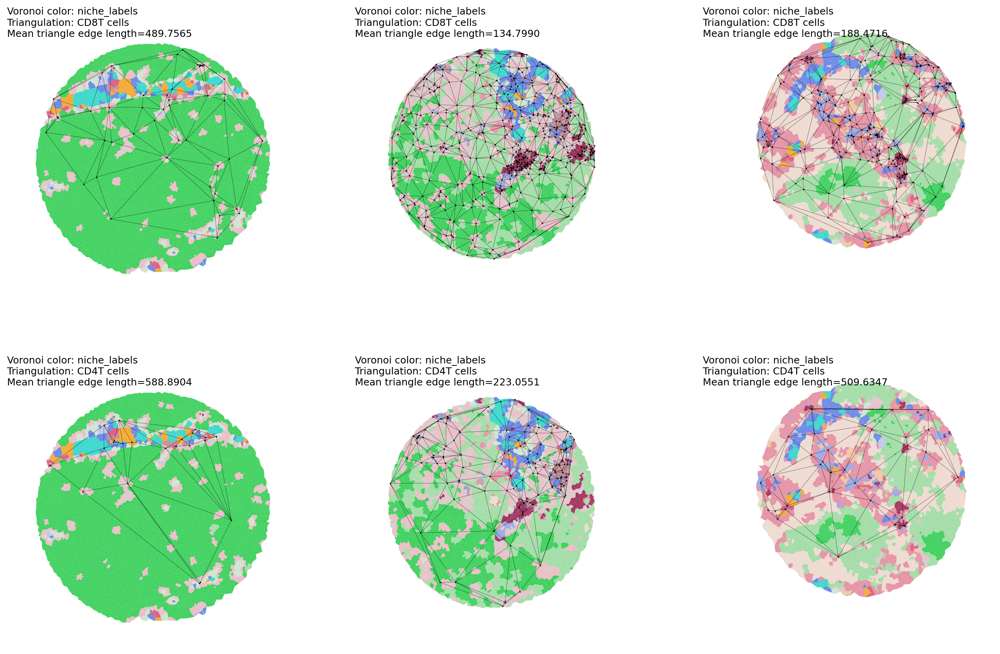

In [9]:
colors = {n:f'{c}' for n,c in zip(np.unique(adata.obs.niche_labels), adata.uns['niche_labels_colors'])}

fig, axs = plt.subplots(2,3, figsize=(18,12), dpi=180)
axs = axs.ravel()

ad = adata[adata.obs.sample_id=='210311_Bladder_TMA3_reg35_v5']
draw_colored_voronoi(ad, ax=axs[0], colors=colors, label_key='niche_labels', highlight_celltype='CD8T', highlight_key='celltype', triangulation=True)
draw_colored_voronoi(ad, ax=axs[3], colors=colors, label_key='niche_labels', highlight_celltype='CD4T', highlight_key='celltype', triangulation=True)

ad = adata[adata.obs.sample_id=='210226_Bladder_TMA1_reg15_v5']
draw_colored_voronoi(ad, ax=axs[1], colors=colors, label_key='niche_labels', highlight_celltype='CD8T', highlight_key='celltype', triangulation=True)
draw_colored_voronoi(ad, ax=axs[4], colors=colors, label_key='niche_labels', highlight_celltype='CD4T', highlight_key='celltype', triangulation=True)

ad = adata[adata.obs.sample_id=='210311_Bladder_TMA3_reg12_v5']
draw_colored_voronoi(ad, ax=axs[2], colors=colors, label_key='niche_labels', highlight_celltype='CD8T', highlight_key='celltype', triangulation=True)
draw_colored_voronoi(ad, ax=axs[5], colors=colors, label_key='niche_labels', highlight_celltype='CD4T', highlight_key='celltype', triangulation=True)

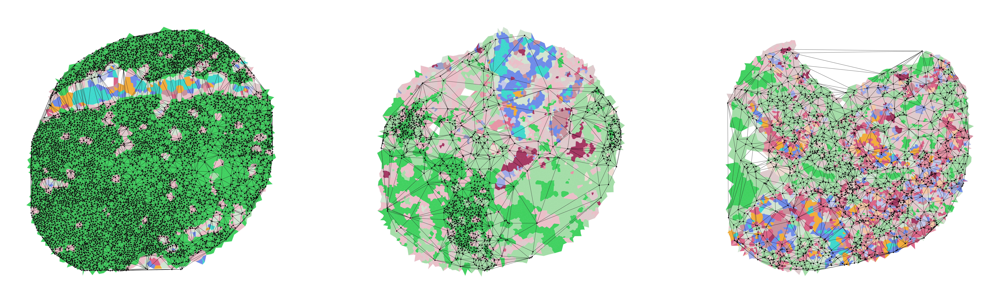

In [109]:
rcParams['figure.dpi'] = 600
colors = {n:f'{c}' for n,c in zip(np.unique(adata.obs.niche_labels), adata.uns['niche_labels_colors'])}

fig, axs = plt.subplots(1,3, figsize=(20,6), dpi=600)
axs = axs.ravel()

kw = dict(colors=colors, label_key='niche_labels', highlight_key='subtype', triangulation=True,
          annotate=False)

ad = adata[adata.obs.sample_id=='210311_Bladder_TMA3_reg35_v5']
draw_colored_voronoi(ad, ax=axs[0], highlight_celltype='Epithelial_KRT13', **kw)

ad = adata[adata.obs.sample_id=='210226_Bladder_TMA1_reg15_v5']
draw_colored_voronoi(ad, ax=axs[1], highlight_celltype='Epithelial_KRT17', **kw)

ad = adata[adata.obs.sample_id=='210311_Bladder_TMA3_reg12_v5']
draw_colored_voronoi(ad, ax=axs[2], highlight_celltype='Epithelial_CDH', **kw)

plt.savefig('figures/epithelial_cell_niche_voronoi.svg', bbox_inches='tight', transparent=True)
plt.savefig('figures/epithelial_cell_niche_voronoi.png', bbox_inches='tight', transparent=True)

# Perform the triangulation only and calculate edge stats

In [332]:
def triangulation(coords):
    tri = Delaunay(coords)

    ds = []
    for triangle in tri.simplices:
        tri_pts = tri.points[triangle]
        for p1, p2 in itertools.combinations(tri_pts, 2):
            d = np.sqrt( (p1[0]-p2[0])**2 + (p1[1]-p2[1])**2 )
            ds.append(d)

    #ds = np.mean(ds)
    return ds

In [398]:
min_cells = 500
# celltype = 'Epithelial_CDH'
celltype_col = 'subtype'
sample_col = 'sample_id'

types = ['Epithelial_KRT13', 'Epithelial_KRT17', 'Epithelial_CDH']

data = []
for celltype in types:
    lengths = {}
    for sample in adata.obs[sample_col].unique():

        ix = (adata.obs[celltype_col]==celltype) & (adata.obs[sample_col]==sample)
        if np.sum(ix) > min_cells:
            cells = adata[ix].obsm['coordinates']
            tri_lens = triangulation(cells)
            lengths[sample] = tri_lens

    l = []
    s = []
    for k,v in lengths.items():
        #l += v
        #s += [k]*len(v)
        l.append(np.mean(v))
        s.append(k)

    df = pd.DataFrame({'mean_edge_length': l, 'sample': s, 'subtype': [celltype]*len(l)})
    data.append(df.copy())

data = pd.concat(data, axis=0)

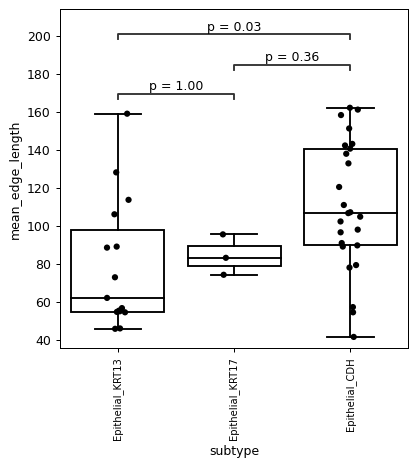

In [399]:
import statannot
import itertools

plt.figure(figsize=(5,5), dpi=90)
ax = plt.gca()

sns.boxplot(x = 'subtype', y = 'mean_edge_length', data=data, ax=ax, color='w',
            order = types,
            fliersize=0, )
sns.stripplot(x = 'subtype', y = 'mean_edge_length', data=data, ax=ax, color='k',
              marker='o',
            order = types, )
statannot.add_stat_annotation(x = 'subtype', y = 'mean_edge_length', data=data, ax=ax, 
              order = types,
              box_pairs =  [(c1,c2) for c1,c2 in itertools.combinations(types,2)] ,
              test='Mann-Whitney',
              text_format='simple',
              verbose=0 )

_ = ax.set_xticklabels(ax.get_xticklabels(), rotation=90, fontsize=8)
for i,box in enumerate(ax.artists):
    box.set_edgecolor('black')
    box.set_facecolor('white')

    # iterate over whiskers and median lines
    for j in range(6*i,6*(i+1)):
         ax.lines[j].set_color('black')

# Draw voronoi from cells in a given area

210308_Bladder_TMA2_reg18_v5    3518
210308_Bladder_TMA2_reg28_v5    3038
210226_Bladder_TMA1_reg19_v5    2988
210226_Bladder_TMA1_reg32_v5    2643
210308_Bladder_TMA2_reg17_v5    2625
                                ... 
210226_Bladder_TMA1_reg14_v5      13
210308_Bladder_TMA2_reg13_v5       8
210311_Bladder_TMA3_reg10_v5       4
210308_Bladder_TMA2_reg1_v5        3
210311_Bladder_TMA3_reg18_v5       1
Name: sample_id, Length: 75, dtype: int64

In [137]:
color_dict = {k:c for k,c in zip(np.unique(adata.obs.subtype), adata.uns['subtype_colors'])}
color_dict['Epithelial'] = '#bcbd22'
color_dict['Epithelial_KRT13_KRT17'] = '#bcbd22'
color_dict['Epithelial_KRT13'] = '#bcbd22'
color_dict['Epithelial_CDH'] = '#1f77b4'
color_dict['Endothelial'] = '#17becf'
color_dict['CD8T_exhausted'] = '#e377c2'
color_dict['CD4T'] = '#ff9896'
color_dict['Stromal'] = '#98df8a'
color_dict['Mac'] = '#aec7e8'
color_dict['Bcell'] = '#ab09ab'

# master_palette = {
#     "ACTA2_Fibroblast": "#ffbb78", 
#     "APC_Macrophage": "#7f7f7f", 
#     "Activated_Bcell": "#c5b0d5", 
#     "CDH12_CDH18_Epithelial": "#1f77b4", 
#     "DSG3_Epithelial": "#ff7f0e", 
#     "Dendritic_cell": "#c49c94", 
#     "Endothelial": "#17becf", 
#     "FAP_Fibroblast": "#8c564b", 
#     "Inflam_Macrophage": "#aec7e8", 
#     "Intermediate_Epithelial": "#2ca02c", 
#     "KRT_Epithelial": "#9467bd", 
#     "Late_Activation_CD8T": "#e377c2", 
#     "Naive_Tcell": "#ff9896", 
#     "PDGFRB_Fibroblast": "#f7b6d2", 
#     "PDPN_Fibroblast": "#98df8a", 
#     "Plasma_Bcell": "#c7c7c7", 
#     "Proliferating_Epithelial": "#d62728", 
#     "Treg": "#dbdb8d", 
#     "KRT_13_17_Epithelial": "#bcbd22", 
# }

subtype_2 = np.array(adata.obs.subtype)
subtype_2[subtype_2 == 'Epithelial_KRT13'] = 'Epithelial_KRT13_KRT17'
subtype_2[subtype_2 == 'Epithelial_KRT17'] = 'Epithelial_KRT13_KRT17'
adata.obs['subtype_2'] = pd.Categorical(subtype_2)

p = []
for u in np.unique(subtype_2):
    p.append(color_dict[u])
adata.uns['subtype_2_colors'] = p

p = []
for u in np.unique(adata.obs.celltype):
    p.append(color_dict[u])
adata.uns['celltype_colors'] = p

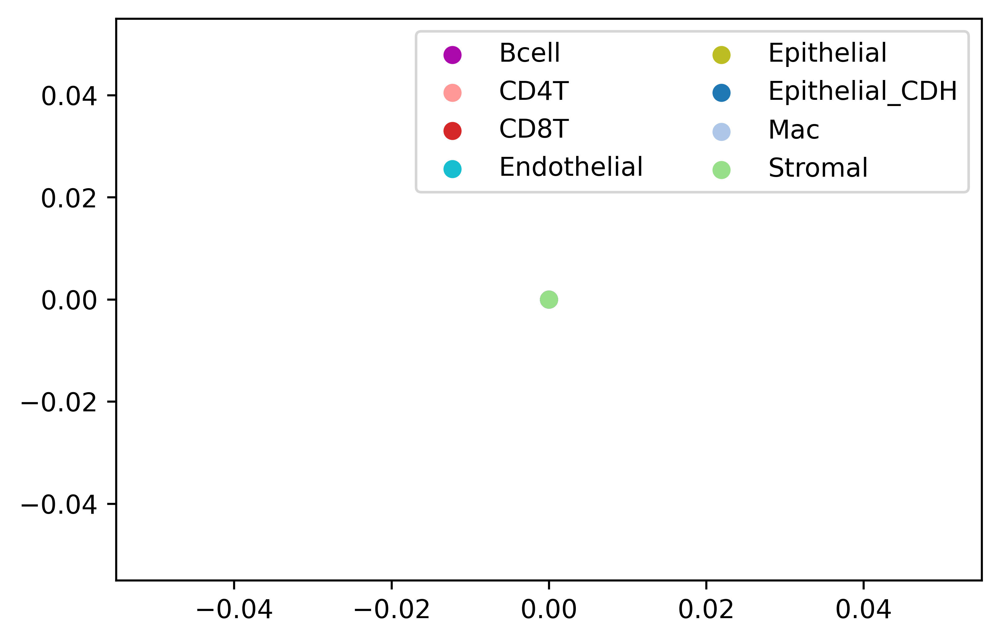

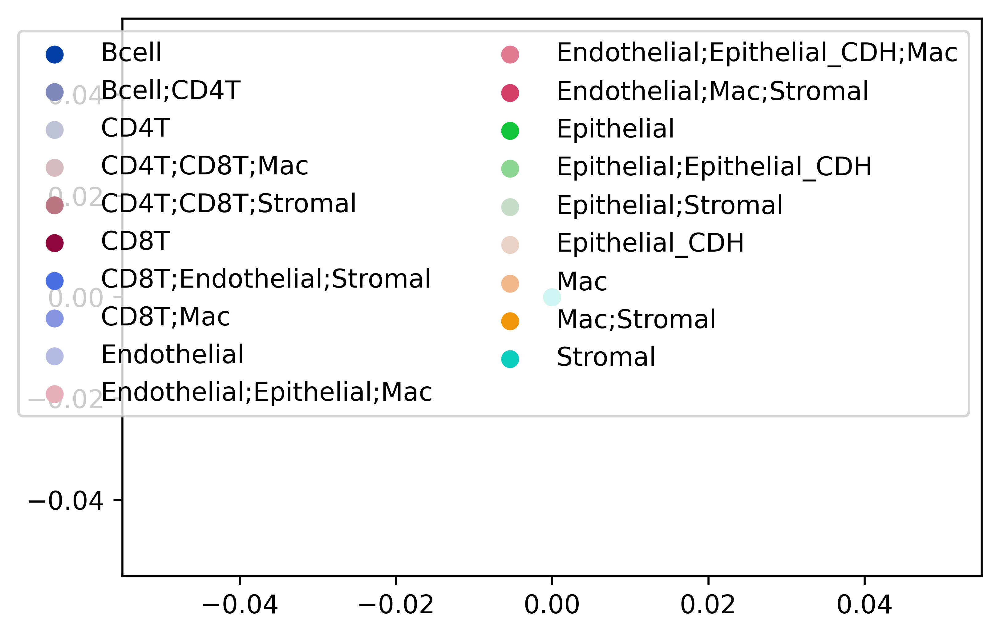

In [138]:
rcParams['svg.fonttype'] = 'none'
plt.figure()
for i,u in enumerate(np.unique(adata.obs.celltype)):
    c = adata.uns['celltype_colors'][i]
    plt.scatter(0,0, color=c, label=u)
plt.legend(ncol=2)
plt.savefig('figures/voronoi_celltype_legend.svg', bbox_inches='tight', transparent=True)

plt.figure()
for i,u in enumerate(np.unique(adata.obs.niche_labels)):
    c = adata.uns['niche_labels_colors'][i]
    plt.scatter(0,0, color=c, label=u)
plt.legend(ncol=2)
plt.savefig('figures/voronoi_niche_labels_legend.svg', bbox_inches='tight', transparent=True)

In [148]:
# 'Endothelial;Epithelial;Mac' 10
# 'Endothelial;Epithelial_CDH;Mac' 11
# 'Epithelial' 13
# 'Epithelial;Epithelial_CDH' 14
# 'Epithelial_CDH' 16
# adata.obs.loc[adata.obs.niche_labels=='Endothelial;Epithelial;Mac', 'sample_id'].value_counts().head(10)
# adata.obs.loc[adata.obs.niche_labels=='Endothelial;Epithelial_CDH;Mac', 'sample_id'].value_counts().head(10)
# adata.obs.loc[adata.obs.niche_labels=='Epithelial', 'sample_id'].value_counts().head(10)
# adata.obs.loc[adata.obs.niche_labels=='Epithelial;Epithelial_CDH', 'sample_id'].value_counts().head(10)
adata.obs.loc[adata.obs.niche_labels=='Epithelial_CDH', 'sample_id'].value_counts().head(10)

210311_Bladder_TMA3_reg18_v5    7884
210308_Bladder_TMA2_reg13_v5    4166
210226_Bladder_TMA1_reg20_v5    1951
210226_Bladder_TMA1_reg14_v5    1366
210311_Bladder_TMA3_reg10_v5    1276
210311_Bladder_TMA3_reg22_v5     405
210226_Bladder_TMA1_reg18_v5     313
210226_Bladder_TMA1_reg31_v5     290
210308_Bladder_TMA2_reg1_v5      276
210308_Bladder_TMA2_reg33_v5     234
Name: sample_id, dtype: int64

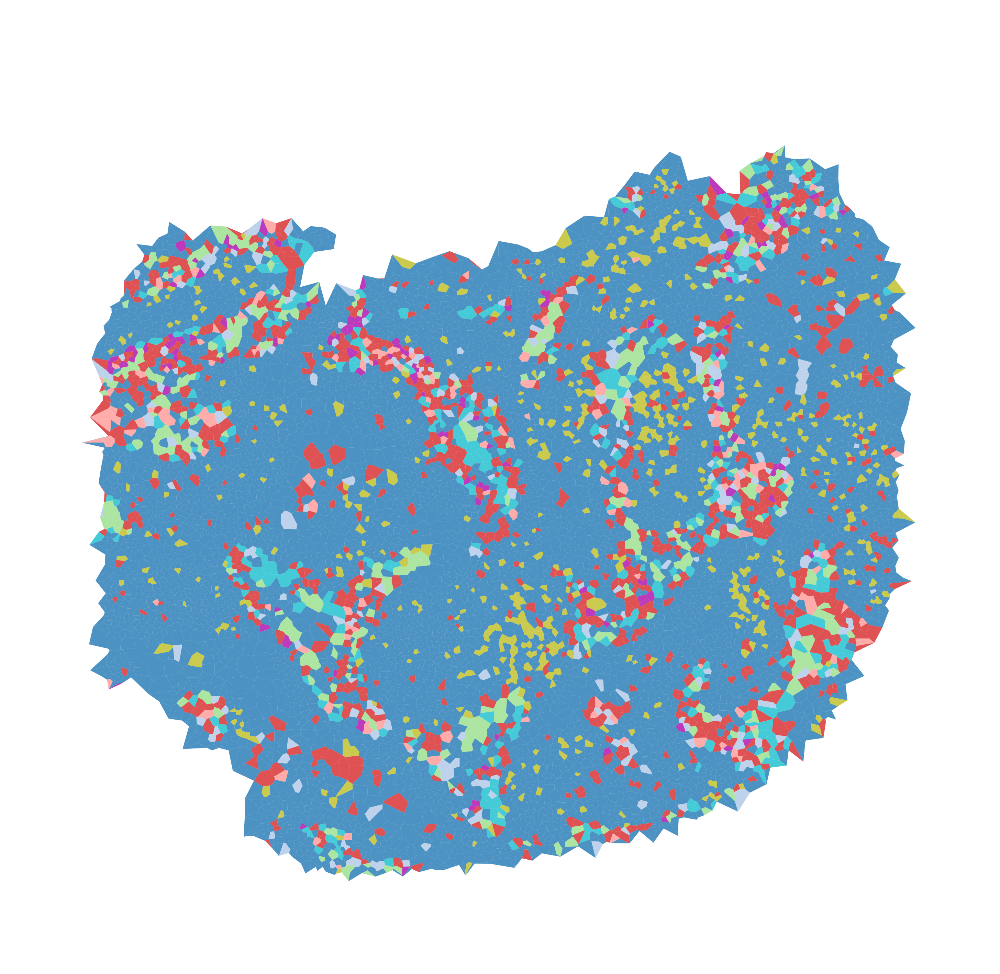

In [149]:
rcParams['figure.dpi'] = 600

niche_colors = {n:f'{c}' for n,c in zip(np.unique(adata.obs.niche_labels), adata.uns['niche_labels_colors'])}
celltype_colors = {n:f'{c}' for n,c in zip(np.unique(adata.obs.celltype), adata.uns['celltype_colors'])}

s = '210311_Bladder_TMA3_reg18_v5'
ad = adata[adata.obs.sample_id==s]

# plt.figure(figsize=(6,6), dpi=600)
# ax = plt.gca()
# draw_colored_voronoi(ad, ax=ax, colors=niche_colors, label_key='niche_labels', annotate=False)
# plt.savefig(f'figures/voronoi/voronoi_{s}_niches.svg', bbox_inches='tight', transparent=True)
# plt.savefig(f'figures/voronoi/voronoi_{s}_niches.png', bbox_inches='tight', transparent=True)

plt.figure(figsize=(6,6), dpi=600)
ax = plt.gca()
draw_colored_voronoi(ad, ax=ax, colors=celltype_colors, label_key='celltype', annotate=False)
plt.savefig(f'figures/voronoi/voronoi_{s}_celltype.svg', bbox_inches='tight', transparent=True)
plt.savefig(f'figures/voronoi/voronoi_{s}_celltype.png', bbox_inches='tight', transparent=True)